# The Spark Foundation - Internship

## Task 4 :  Exploratory Data Analysis - Terrorism
Performing ‘Exploratory Data Analysis’ on dataset ‘Global Terrorism’

### Author - Md. Muntasirul Hoque

### Importing Needed packages

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import pylab as pl
import numpy as np
import seaborn as sns
%matplotlib inline

#### Suppress warnings

In [2]:
import warnings
warnings.filterwarnings('ignore')

### Reading The Data

In [3]:
# Reading data from remote link

df = pd.read_csv('globalterrorismdb_0718dist.csv',engine='python')
print("Data imported successfully")

Data imported successfully


### Data Exploration
Lets first have a descriptive exploration on our data.

In [4]:
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [5]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [6]:
df.shape

(181691, 135)

In [7]:
df.columns.values  

array(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region', 'region_txt',
       'provstate', 'city', 'latitude', 'longitude', 'specificity',
       'vicinity', 'location', 'summary', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'alternative', 'alternative_txt', 'multiple',
       'success', 'suicide', 'attacktype1', 'attacktype1_txt',
       'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt',
       'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt',
       'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2',
       'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2',
       'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt',
       'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3',
       'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2',
       'gname3', 'gsubname3', 'motive', 'guncertain1', 'guncertain2',
       'guncertain3', 'in

In [8]:
df = df[["iyear", "imonth", "attacktype1_txt","iday","country", "country_txt", "region_txt", "city","success", "attacktype1_txt","nkill", "propvalue", "targtype1_txt","latitude","gname","nwound","longitude", "targsubtype1_txt","target1","weaptype1_txt", "weapdetail"]]

In [9]:
df.rename(columns = {'iyear':'Year', "imonth":"Month","attacktype1_txt":"attacktype1","iday":"Day", "country":"Country_no",
                     "country_txt":"Country","region_txt":"Region","city":"City", "propvalue":"property_value",
                     "attacktype1_txt":"Attack_type", "targtype1_txt":"Target_type","gname":"group_name",
                     "targsubtype1_txt":"Target_sub_type", "target1":"Target", "nkill":"no_of_kills","nwound":"wond",
                     "weaptype1_txt":"Weapon_type", "weapdetail":"Weapon_detail"}, inplace = True)  # Renaming the column values...

In [10]:
df.isnull().sum()  

Year                    0
Month                   0
Attack_type             0
Day                     0
Country_no              0
Country                 0
Region                  0
City                  434
success                 0
Attack_type             0
no_of_kills         10313
property_value     142702
Target_type             0
latitude             4556
group_name              0
wond                16311
longitude            4557
Target_sub_type     10373
Target                636
Weapon_type             0
Weapon_detail       67670
dtype: int64

In [11]:
df.shape

(181691, 21)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 21 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Year             181691 non-null  int64  
 1   Month            181691 non-null  int64  
 2   Attack_type      181691 non-null  object 
 3   Day              181691 non-null  int64  
 4   Country_no       181691 non-null  int64  
 5   Country          181691 non-null  object 
 6   Region           181691 non-null  object 
 7   City             181257 non-null  object 
 8   success          181691 non-null  int64  
 9   Attack_type      181691 non-null  object 
 10  no_of_kills      171378 non-null  float64
 11  property_value   38989 non-null   float64
 12  Target_type      181691 non-null  object 
 13  latitude         177135 non-null  float64
 14  group_name       181691 non-null  object 
 15  wond             165380 non-null  float64
 16  longitude        177134 non-null  floa

In [13]:
df.head()

,Year,Month,Attack_type,Day,Country_no,Country,Region,City,success,Attack_type,...,property_value,Target_type,latitude,group_name,wond,longitude,Target_sub_type,Target,Weapon_type,Weapon_detail
0,1970,7,Assassination,2,58,Dominican Republic,Central America & Caribbean,Santo Domingo,1,Assassination,...,NaN,Private Citizens & Property,18.456792,MANO-D,0.0,-69.951164,Named Civilian,Julio Guzman,Unknown,NaN
1,1970,0,Hostage Taking (Kidnapping),0,130,Mexico,North America,Mexico city,1,Hostage Taking (Kidnapping),...,NaN,Government (Diplomatic),19.371887,23rd of September Communist League,0.0,-99.086624,"Diplomatic Personnel (outside of embassy, cons...","Nadine Chaval, daughter",Unknown,NaN
2,1970,1,Assassination,0,160,Philippines,Southeast Asia,Unknown,1,Assassination,...,NaN,Journalists & Media,15.478598,Unknown,0.0,120.599741,Radio Journalist/Staff/Facility,Employee,Unknown,NaN
3,1970,1,Bombing/Explosion,0,78,Greece,Western Europe,Athens,1,Bombing/Explosion,...,NaN,Government (Diplomatic),37.997490,Unknown,NaN,23.762728,Embassy/Consulate,U.S. Embassy,Explosives,Explosive
4,1970,1,Facility/Infrastructure Attack,0,101,Japan,East Asia,Fukouka,1,Facility/Infrastructure Attack,...,NaN,Government (Diplomatic),33.580412,Unknown,NaN,130.396361,Embassy/Consulate,U.S. Consulate,Incendiary,Incendiary


In [14]:
df.isnull().sum()

Year                    0
Month                   0
Attack_type             0
Day                     0
Country_no              0
Country                 0
Region                  0
City                  434
success                 0
Attack_type             0
no_of_kills         10313
property_value     142702
Target_type             0
latitude             4556
group_name              0
wond                16311
longitude            4557
Target_sub_type     10373
Target                636
Weapon_type             0
Weapon_detail       67670
dtype: int64

In [15]:
def impute_nan(df,variable,median):
    df[variable].fillna(median,inplace=True)

In [16]:
median=df.no_of_kills.median()

In [17]:
impute_nan(df,"no_of_kills",median)

In [18]:
median=df.longitude.median()

In [19]:
impute_nan(df,"longitude",median)

In [20]:
median=df.latitude.median()

In [21]:
impute_nan(df,"latitude",median)

In [22]:
df.isnull().sum()

Year                    0
Month                   0
Attack_type             0
Day                     0
Country_no              0
Country                 0
Region                  0
City                  434
success                 0
Attack_type             0
no_of_kills         10313
property_value     142702
Target_type             0
latitude             4556
group_name              0
wond                16311
longitude            4557
Target_sub_type     10373
Target                636
Weapon_type             0
Weapon_detail       67670
dtype: int64

In [23]:
df['Target_sub_type'].value_counts()

Unnamed Civilian/Unspecified                               11596
Police Security Forces/Officers                            11178
Military Unit/Patrol/Convoy                                 8277
Military Personnel (soldiers, troops, officers, forces)     7963
Government Personnel (excluding police, military)           6610
                                                           ...  
Multiple Telecommunication Targets                            31
Fire Fighter/Truck                                            27
Oil Tanker                                                    19
Personnel                                                     19
Internet Infrastructure                                       12
Name: Target_sub_type, Length: 112, dtype: int64

In [24]:
df["City"].fillna("Unknown", inplace = True)
df["Target"].fillna("Unknown", inplace = True)
df["property_value"].fillna(0, inplace = True)


In [25]:
df.isnull().sum()

Year                    0
Month                   0
Attack_type             0
Day                     0
Country_no              0
Country                 0
Region                  0
City                  434
success                 0
Attack_type             0
no_of_kills         10313
property_value     142702
Target_type             0
latitude             4556
group_name              0
wond                16311
longitude            4557
Target_sub_type     10373
Target                636
Weapon_type             0
Weapon_detail       67670
dtype: int64

In [26]:
df['casualities']=df['no_of_kills']+df['wond']

print('Country with Highest Terrorist Attacks:',df['Country'].value_counts().index[0])
print('Regions with Highest Terrorist Attacks:',df['Region'].value_counts().index[0])
print('Maximum people killed in an attack are:',df['no_of_kills'].max(),'that took place in',df.loc[df['no_of_kills'].idxmax()].Country)
print("Year with the most attacks:",df['Year'].value_counts().idxmax())
print("Month with the most attacks:",df['Month'].value_counts().idxmax())


Country with Highest Terrorist Attacks: Iraq
Regions with Highest Terrorist Attacks: Middle East & North Africa
Maximum people killed in an attack are: 1570.0 that took place in Iraq
Year with the most attacks: 2014
Month with the most attacks: 5


### Attack Count By year

<AxesSubplot:title={'center':'Attack Count by year'}, xlabel='Year', ylabel='count'>

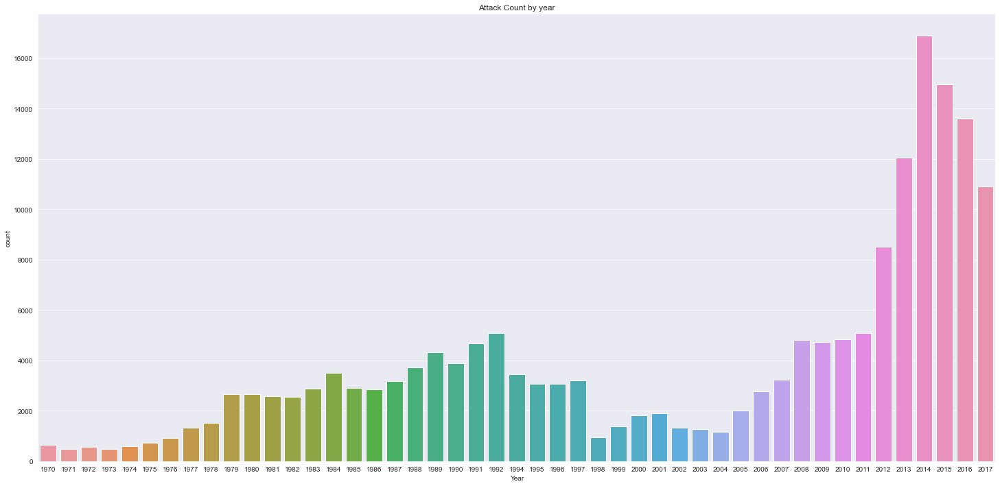

In [27]:
sns.set_style('darkgrid')
plt.figure(figsize=(25,12))   #  Incresing figure size...
plt.title("Attack Count by year")  # Giving title to the graph...
sns.countplot(x ='Year', data = df)  # Using Count Plot...

### Percentage of Success vs Failure

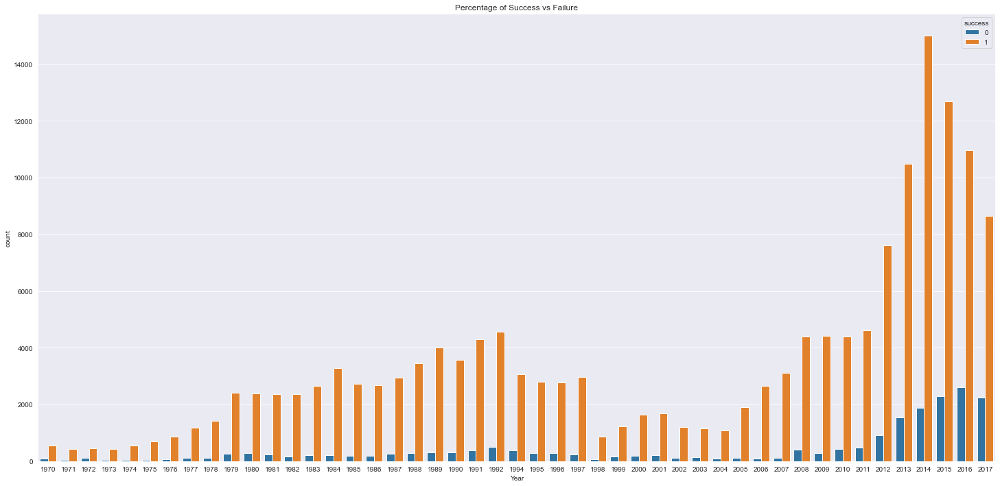

In [28]:
plt.figure(figsize=(25,12))   
plt.title("Percentage of Success vs Failure") # printing the title
sns.set_style('darkgrid')  # Making background in a stylish format
sns.countplot(x ='Year', hue = "success", data = df)  #using countplot with year and success
plt.show() # showing the plot...


### Attack vs kills 

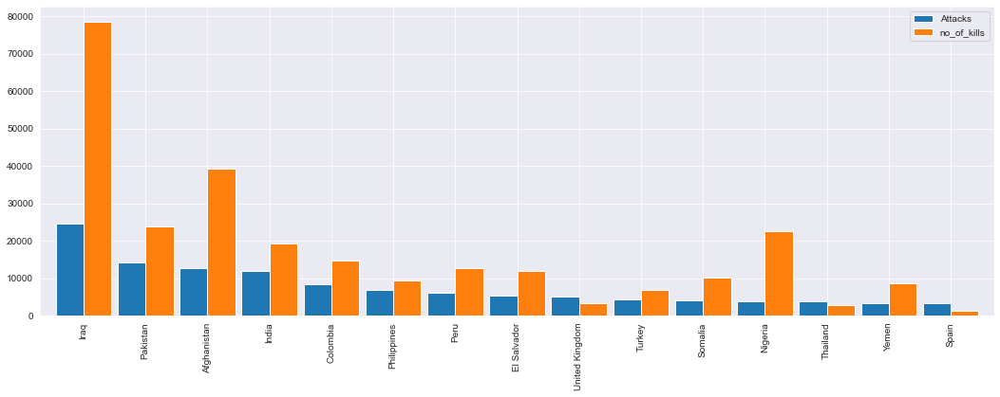

In [29]:
count_terror=df['Country'].value_counts()[:15].to_frame()
count_terror.columns=['Attacks']
count_kill=df.groupby('Country')['no_of_kills'].sum().to_frame()
count_terror.merge(count_kill,left_index=True,right_index=True,how='left').plot.bar(width=0.9)
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

### Region-Wise Attack Count

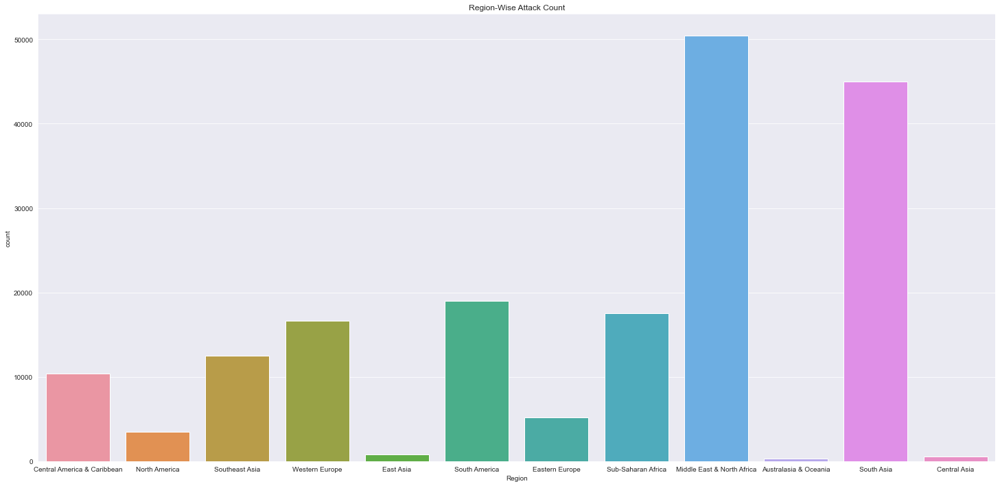

In [30]:
plt.figure(figsize=(25,12))   #  Incresing figure size...
sns.set_style('darkgrid')
plt.title("Region-Wise Attack Count")  # Giving title to the graph...
_=sns.countplot(x ='Region', data = df)  # Using Count Plot...

### Countries with highest terrorist attacks

The highest terrorist attacks were commited in Iraq with 24636 attacks

The other 9 countries with highest terrorist attacks are:
2. Pakistan with 14368 attacks
3. Afghanistan with 12731 attacks
4. India with 11960 attacks
5. Colombia with 8306 attacks
6. Philippines with 6908 attacks
7. Peru with 6096 attacks
8. El Salvador with 5320 attacks
9. United Kingdom with 5235 attacks
10. Turkey with 4292 attacks


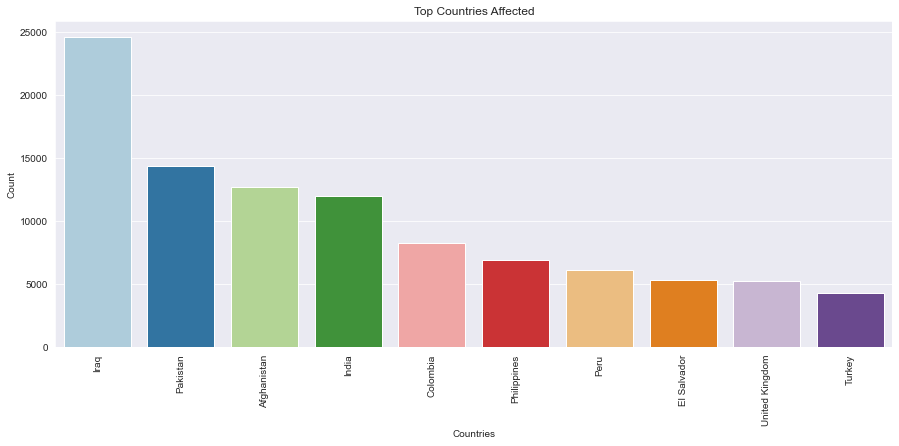

In [31]:
print(f"The highest terrorist attacks were commited in {df.Country.value_counts().index[0]} with {df.Country_no.value_counts().max()} attacks")

print('\nThe other 9 countries with highest terrorist attacks are:')
for i in range(1,10):
    print(f"{i+1}. {df.Country.value_counts().index[i]} with {df.Country.value_counts()[i]} attacks")

#Visualization
plt.subplots(figsize=(15,6))
sns.barplot(df['Country'].value_counts()[:10].index,df['Country'].value_counts()[:10].values,palette='Paired')
plt.title('Top Countries Affected')
plt.xlabel('Countries')
plt.ylabel('Count')
plt.xticks(rotation= 90)
plt.show()

In [32]:
import plotly.express as px

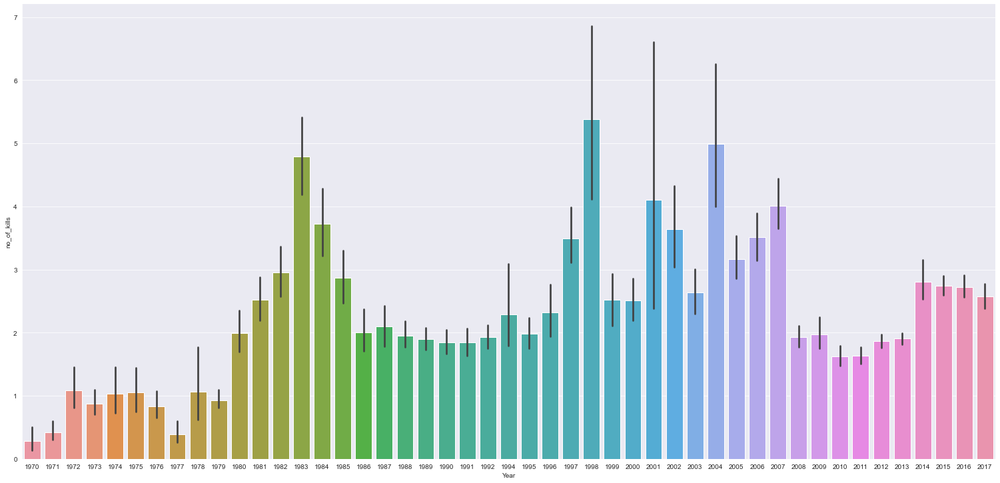

In [33]:
sns.set_style('darkgrid')
_ = sns.catplot(x ='Year', y ='no_of_kills', data = df, kind ='bar',height=10, aspect=27/13)

### Terrorist Groups with Highest Terror Attacks

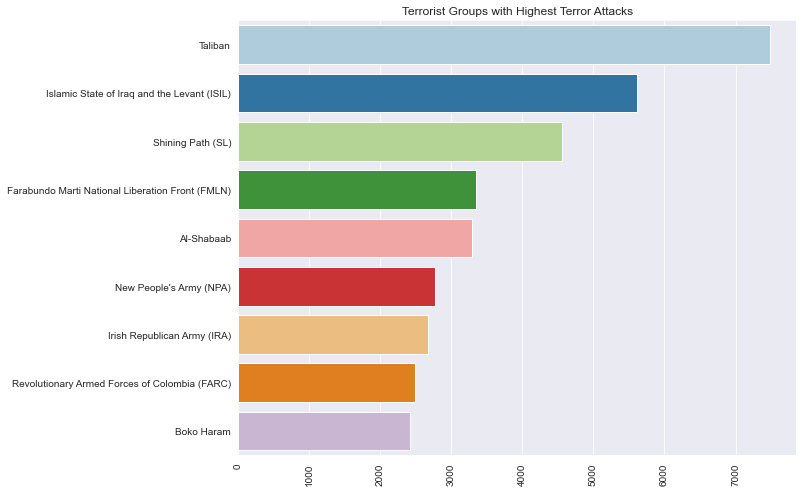

In [34]:
sns.barplot(df['group_name'].value_counts()[1:10].values,df['group_name'].value_counts()[1:10].index,palette='Paired')
plt.xticks(rotation=90)
fig=plt.gcf()
fig.set_size_inches(10,8)
plt.title('Terrorist Groups with Highest Terror Attacks')
plt.show()

### Number of Kills in Each Target

In [35]:
px.pie(df, values='no_of_kills', names='Target_type', title='Number of Kills in each target') # using piechart to display the number of kills in each target

### Most common target

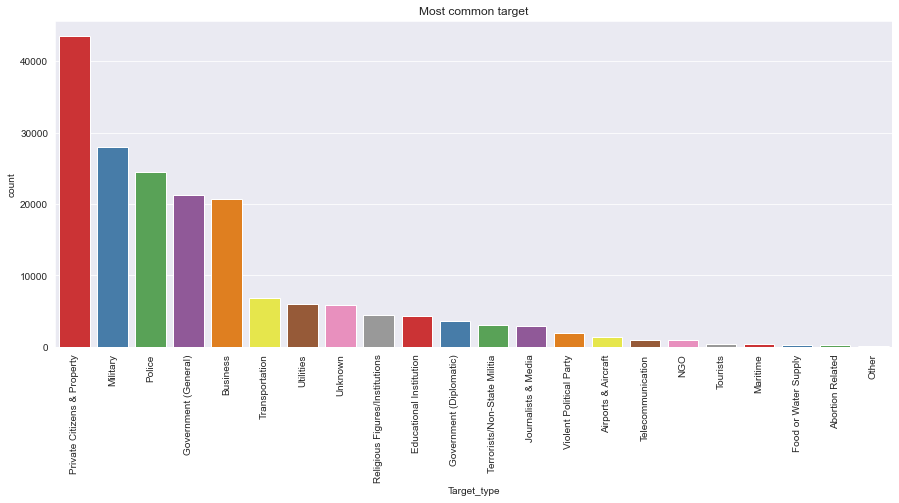

In [36]:
plt.subplots(figsize=(15,6))
sns.countplot(df['Target_type'],palette='Set1',order=df['Target_type'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Most common target')
plt.show()

### Top Cities affected by Terror Attacks

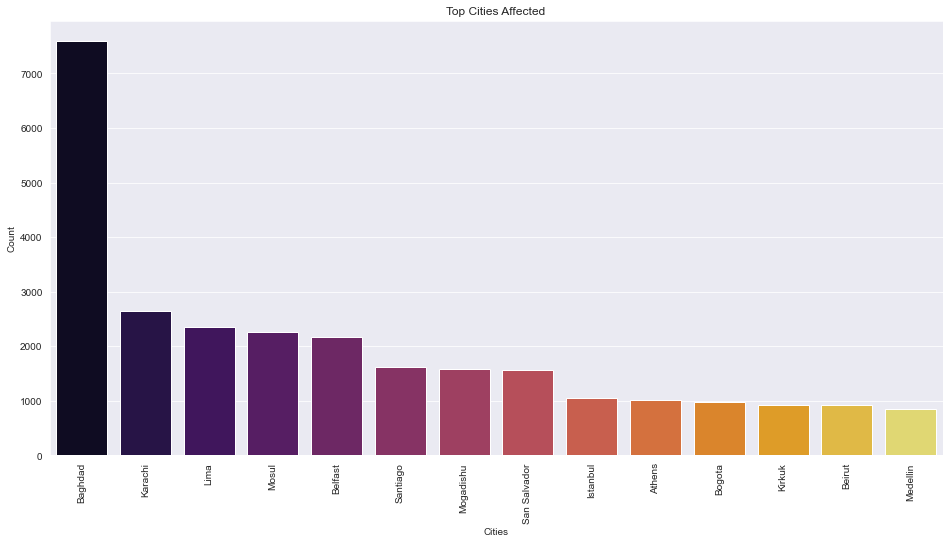

In [37]:
plt.subplots(figsize=(16,8))
sns.barplot(df['City'].value_counts()[1:15].index,df['City'].value_counts()[1:15].values,palette='inferno')
plt.title('Top Cities Affected')
plt.xlabel('Cities')
plt.ylabel('Count')
plt.xticks(rotation= 90)
plt.show()

### Weapon Type

In [38]:
df["Weapon_type"].value_counts()

Explosives                                                                     92426
Firearms                                                                       58524
Unknown                                                                        15157
Incendiary                                                                     11135
Melee                                                                           3655
Chemical                                                                         321
Sabotage Equipment                                                               141
Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)      136
Other                                                                            114
Biological                                                                        35
Fake Weapons                                                                      33
Radiological                                                     

### Type of Weapon Attacked by Terrorists

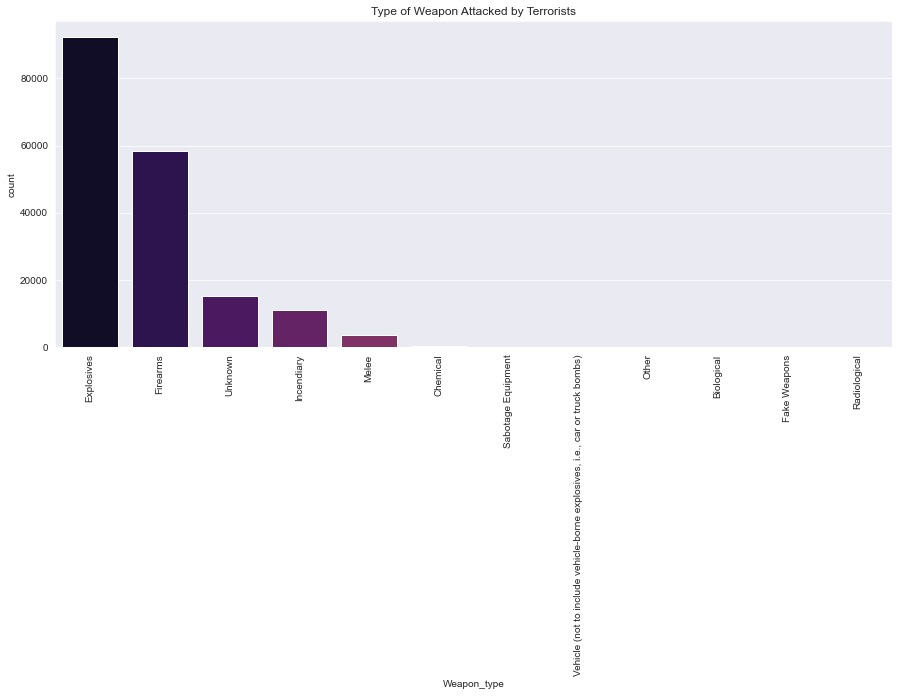

In [39]:
plt.subplots(figsize=(15,6))
sns.countplot('Weapon_type',data=df,palette='inferno',order=df['Weapon_type'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Type of Weapon Attacked by Terrorists')
plt.show()

### World-wide map of Terrorism

In [40]:
import folium
import folium.plugins
import io


In [41]:
terror_fol=df.copy()
terror_fol.dropna(subset=['latitude','longitude'],inplace=True)
location_fol=terror_fol[['latitude','longitude']][:8000]
country_fol=terror_fol['Country'][:8000]
city_fol=terror_fol['City'][:8000]
killed_fol=terror_fol['no_of_kills'][:8000]
wound_fol=terror_fol['wond'][:8000]
def color_point(x):
    if x>=30:
        color='red'
    elif ((x>0 and x<30)):
        color='blue'
    else:
        color='orange'
    return color   
def point_size(x):
    if (x>30 and x<100):
        size=2
    elif (x>=100 and x<500):
        size=8
    elif x>=500:
        size=16
    else:
        size=0.5
    return size   
map2 = folium.Map(location=[30,0],tiles='cartodbpositron',zoom_start=2)
for point in location_fol.index:
    info='<b>Country: </b>'+str(country_fol[point])+'<br><b>City: </b>: '+str(city_fol[point])+'<br><b>Killed </b>: '+str(killed_fol[point])+'<br><b>Wounded</b> : '+str(wound_fol[point])
    iframe = folium.IFrame(html=info, width=200, height=200)
    folium.CircleMarker(list(location_fol.loc[point].values),popup=folium.Popup(iframe),radius=point_size(killed_fol[point]),color=color_point(killed_fol[point])).add_to(map2)
map2